# Pandas Exercise
### Libray importing & etc

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import matplotlib.pyplot as plt
from matplotlib import rcParams
import numpy as np
from pathlib import Path
import pandas as pd
import seaborn as sns
import warnings

In [4]:
rcParams['figure.figsize'] = (16, 8)
plt.style.use('fivethirtyeight')
pd.set_option('max_columns', 100)
pd.set_option("display.precision", 4)
warnings.simplefilter('ignore')

### Data loading

In [11]:
data_dir=Path('../data/dacon-dku')
trn_file = data_dir / 'train.csv'
tst_file = data_dir / 'test.csv'
feature_file = data_dir / 'feature.csv'
seed = 42

In [ ]:
trn = pd.read_csv(trn_file,index_col=0)
trn

In [ ]:
tst = pd.read_csv(tst_file, index_col=0)
tst

## EDA

### 데이터 개요

In [17]:
trn = pd.read_csv(trn_file, index_col=0)
print(trn.shape)
trn.head()

(320000, 19)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
0,23.2640,20.3368,19.0095,17.6724,16.9396,-8.1086e-05,23.1243,20.2578,18.9551,17.6321,16.9089,18,18,1.1898,1.1907,1.1890,1.1894,1.1902,0
1,15.0521,14.0620,13.4524,13.2684,13.1689,4.5061e-03,14.9664,14.0045,13.4114,13.2363,13.1347,1,1,1.2533,1.2578,1.2488,1.2510,1.2555,1
2,16.7864,15.8254,15.5363,15.3935,15.3500,4.7198e-04,16.6076,15.6866,15.4400,15.3217,15.2961,2,2,1.0225,1.0241,1.0210,1.0217,1.0233,0
3,25.6606,21.1887,20.2212,19.8949,19.6346,5.8143e-06,25.3536,20.9947,20.0873,19.7947,19.5552,4,3,1.2054,1.2061,1.2049,1.2051,1.2057,0
4,24.4534,20.6992,19.0424,18.3242,17.9826,-3.3247e-05,23.7714,20.4338,18.8630,18.1903,17.8759,13,12,1.1939,1.1943,1.1937,1.1938,1.1941,0


In [19]:
trn.tail()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
319995,18.365648,17.240883,16.773898,16.484970,16.340403,0.051988,18.13280,17.04065,16.63744,16.38606,16.28741,2,2,1.093010,1.088828,1.097310,1.095145,1.090905,2
319996,18.685639,17.665802,17.190434,16.816858,16.636688,0.087261,18.52074,17.51310,17.08711,16.74363,16.60173,2,2,1.051689,1.050838,1.052640,1.052152,1.051252,1
319997,21.188972,18.423357,17.295610,16.901072,16.684127,-0.000010,20.98896,18.30760,17.21518,16.84030,16.63555,31,30,1.193259,1.194140,1.192509,1.192868,1.193683,0
319998,18.847187,17.318605,16.505729,16.180571,15.911624,-0.000045,16.38998,15.40578,15.18229,15.19693,15.17935,1,1,1.172458,1.172561,1.172481,1.172454,1.172493,0
319999,19.860438,18.819866,18.515579,18.414884,18.307998,-0.000965,19.82565,18.78191,18.49081,18.39869,18.30977,1,1,1.057076,1.056240,1.057976,1.057518,1.056650,0


In [18]:
trn.describe()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
count,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,3.2000e+05,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000,320000.0000
mean,19.8524,18.3768,17.7358,17.1742,16.8752,5.8308e-02,19.6289,18.2271,17.6154,17.1523,16.8693,6.3327,6.1388,1.1758,1.1765,1.1751,1.1754,1.1761,1.1163
std,1.9455,31.1108,1.4662,52.5615,57.1463,5.7546e-01,1.9236,17.7866,1.4730,25.0758,35.4365,8.8811,8.5516,0.1163,0.1181,0.1147,0.1155,0.1172,0.9235
min,-17.6875,-17555.3656,7.7314,-23955.8178,-23955.8178,-1.6605e+02,-42.8375,-9999.0000,-16.3802,-9999.0000,-9999.0000,1.0000,1.0000,1.0001,1.0000,1.0002,1.0001,1.0000,0.0000
25%,18.7242,17.4749,16.8772,16.5239,16.2889,3.5580e-05,18.5636,17.3484,16.7871,16.4530,16.2341,1.0000,1.0000,1.0882,1.0884,1.0878,1.0880,1.0883,0.0000
50%,19.4194,18.1405,17.5258,17.1497,16.9176,4.7129e-02,19.2646,18.0224,17.4434,17.0874,16.8694,2.0000,2.0000,1.1793,1.1792,1.1794,1.1794,1.1793,1.0000
75%,20.4321,19.0732,18.4281,18.0074,17.7289,9.4597e-02,20.1976,18.8884,18.2911,17.9070,17.6557,5.0000,5.0000,1.2275,1.2260,1.2292,1.2286,1.2268,2.0000
max,58.6233,46.3383,72.0097,50.1641,52.6127,6.2323e+01,30.7779,30.6132,31.9572,32.0162,30.7813,44.0000,42.0000,2.0508,2.0803,2.0221,2.0363,2.0654,2.0000


In [19]:
trn.dtypes

u            float64
g            float64
r            float64
i            float64
z            float64
redshift     float64
dered_u      float64
dered_g      float64
dered_r      float64
dered_i      float64
dered_z      float64
nObserve       int64
nDetect        int64
airmass_u    float64
airmass_g    float64
airmass_r    float64
airmass_i    float64
airmass_z    float64
class          int64
dtype: object

### 변수 분포

In [20]:
trn['class'].value_counts().sort_index()

0    119996
1     42785
2    157219
Name: class, dtype: int64

<AxesSubplot:>

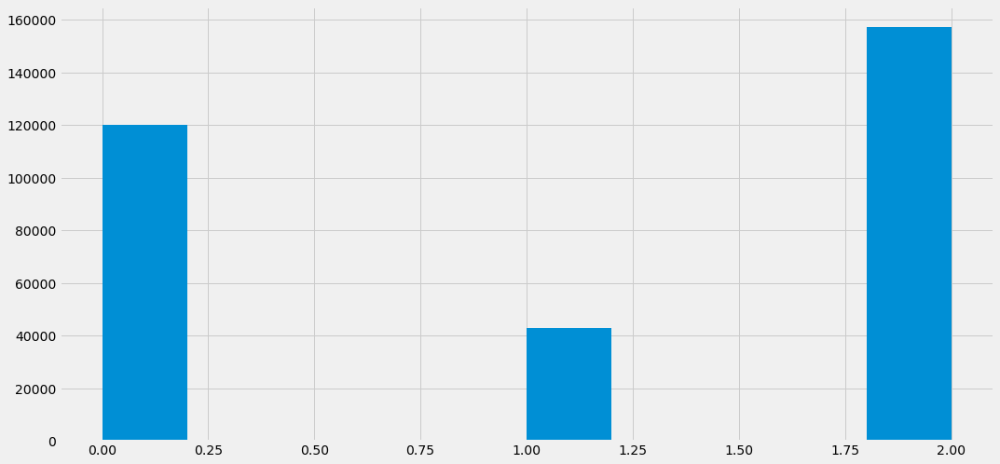

In [21]:
trn['class'].hist()

<AxesSubplot:>

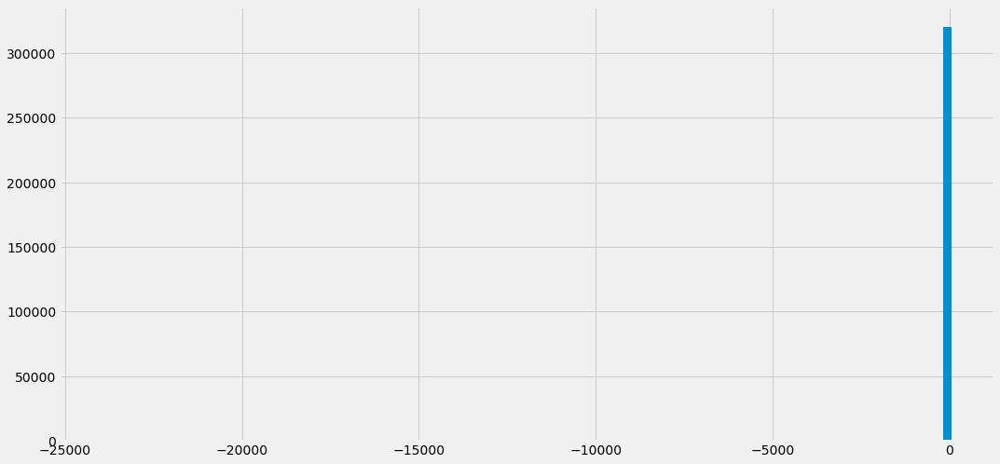

In [22]:
trn['i'].hist(bins=100)

In [23]:
trn['i'].quantile(np.arange(0,1,0.01))    # 1 ~ 100 % 값 만듬

0.00   -23955.8178
0.01       14.4575
0.02       14.8731
0.03       15.0952
0.04       15.2494
           ...    
0.95       19.6769
0.96       19.8682
0.97       20.0562
0.98       20.2517
0.99       20.6046
Name: i, Length: 100, dtype: float64

In [24]:
# check negative number
trn.loc[trn['i']<0]

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
107428,19.3774,18.2789,17.9404,-23955.8178,-23955.8178,0.0671,19.1142,18.1270,17.8280,-9999.0000,-9999.0000,5,4,1.3060,1.3121,1.3002,1.3031,1.3090,2
134102,18.0590,19.3009,19.0443,-5.4550,13.4289,0.0349,18.0384,19.4843,19.3937,23.6095,24.1169,1,1,1.0693,1.0710,1.0678,1.0685,1.0701,2
173287,19.9833,-17555.3656,17.9093,-17555.3656,-17555.3656,0.0932,19.7719,-9999.0000,17.8146,-9999.0000,-9999.0000,5,4,1.3061,1.3121,1.3002,1.3031,1.3090,1
181371,14.6680,14.0357,13.7587,-23.9024,13.5329,0.0007,14.5893,13.9768,13.7133,24.4559,13.5264,2,2,1.2933,1.2867,1.3000,1.2966,1.2900,1


In [25]:
trn['dered_i'].quantile(np.arange(0,1,0.01))

0.00   -9999.0000
0.01      14.1238
0.02      14.6338
0.03      14.9256
0.04      15.1070
          ...    
0.95      19.6019
0.96      19.7939
0.97      19.9848
0.98      20.1736
0.99      20.5396
Name: dered_i, Length: 100, dtype: float64

In [26]:
trn.loc[trn['dered_i']<0]

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
75409,24.0610,23.8879,20.5890,18.1014,16.4314,1.6993e-04,-30.6337,-18.6560,-8.7560,-3.6973,0.2159,11,8,1.1858,1.1859,1.1859,1.1858,1.1858,0
107428,19.3774,18.2789,17.9404,-23955.8178,-23955.8178,6.7144e-02,19.1142,18.1270,17.8280,-9999.0000,-9999.0000,5,4,1.3060,1.3121,1.3002,1.3031,1.3090,2
173287,19.9833,-17555.3656,17.9093,-17555.3656,-17555.3656,9.3168e-02,19.7719,-9999.0000,17.8146,-9999.0000,-9999.0000,5,4,1.3061,1.3121,1.3002,1.3031,1.3090,1
203328,19.1628,17.7936,16.2919,15.1547,14.2541,2.1426e-04,-35.8185,-25.0458,-13.3443,-6.8683,-2.1271,10,9,1.2710,1.2660,1.2762,1.2735,1.2685,0
218728,22.2886,19.7721,17.6775,16.3672,15.1206,1.6016e-04,-41.0768,-29.4654,-16.3802,-8.9412,-3.7059,6,4,1.1851,1.1852,1.1852,1.1851,1.1852,0
294574,22.7283,20.9049,19.4225,17.8771,17.0411,-7.0816e-06,-42.8375,-30.3208,-16.0172,-8.4604,-2.5462,5,3,1.2579,1.2533,1.2627,1.2603,1.2556,0
295627,23.5286,20.9588,19.4514,17.8901,17.0632,-2.0197e-05,-42.8375,-30.3208,-16.0172,-8.4604,-2.5462,5,3,1.2579,1.2533,1.2627,1.2603,1.2556,0


### Visualization

In [ ]:
# 32만개 모두 한번에 하면 안되므로 샘플링 함수 사용
trn_sample = trn.sample(n=10000, random_state=seed)
sns.pairplot(data=trn_sample, vars=['u','g','r','i','z'], hue='class', size=5)

In [ ]:
sns.pairplot(data=trn_sample, vars=['dered_u','dered_g','dered_r','dered_i','dered_z'], hue='class', size=5)

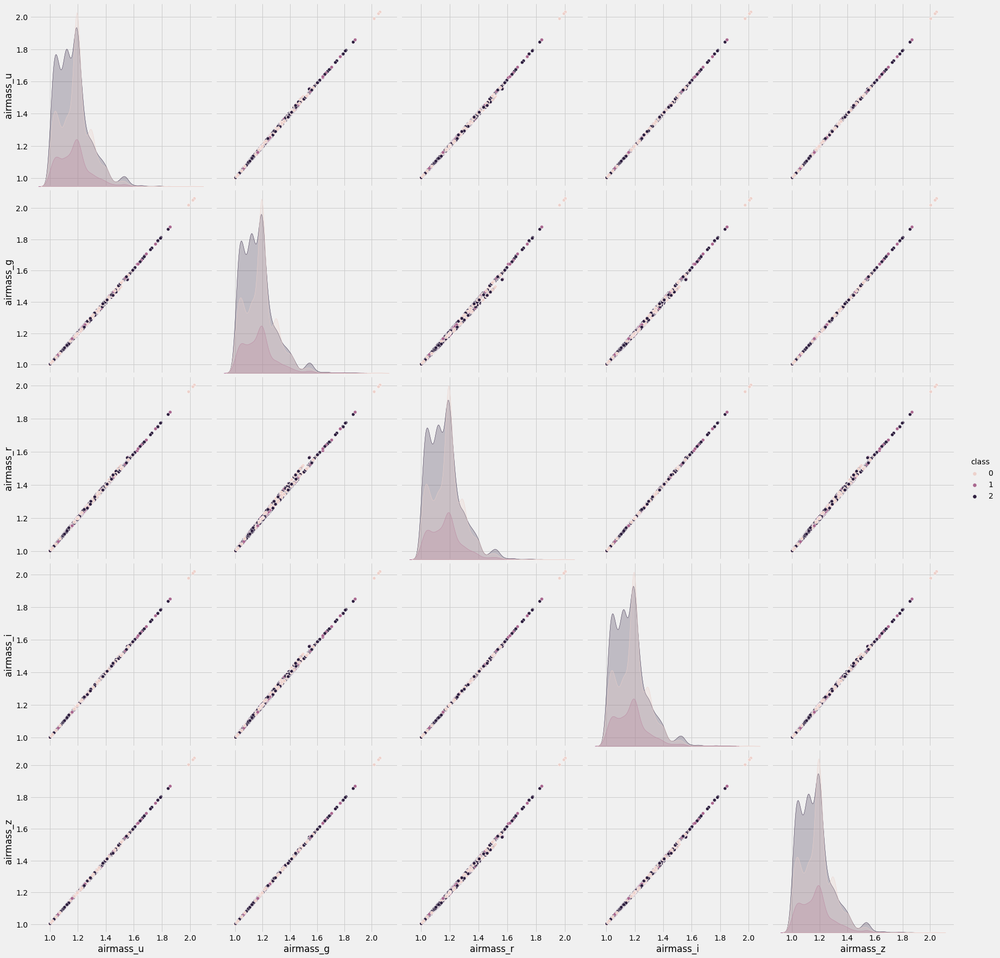

In [29]:
sns.pairplot(data=trn_sample, vars=['airmass_u','airmass_g','airmass_r','airmass_i','airmass_z'], hue='class', size=5)

# 거의 일치하므로 이 중 하나만 있으면 되겠구나 라는 유추를 할 수 있다.

In [ ]:
sns.pairplot(data=trn_sample, vars=['u','dered_u','airmass_u'], hue='class', size=5)

In [ ]:
sns.pairplot(data=trn_sample, vars=['redshift','nObserve','nDetect'], hue='class', size=5)

In [32]:
# groupby : 하나의 기준을 group으로 만들고 계산을 할때 사용
trn.groupby('class').mean()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z
class,,,,,,,,,,,,,,,,,,
0,20.8648,19.2129,18.3938,17.8377,17.5528,-0.0024,20.5223,18.9474,18.2100,17.7011,17.4511,8.5553,8.3138,1.1864,1.1873,1.1856,1.1860,1.1868
1,19.2710,17.8776,17.8412,17.1333,17.0058,0.1055,19.1071,17.9267,17.7526,17.2447,17.1343,7.0451,6.7588,1.1776,1.1784,1.1770,1.1773,1.1780
2,19.2380,17.8746,17.2048,16.6790,16.3225,0.0918,19.0890,17.7590,17.1243,16.7084,16.3531,4.4425,4.3101,1.1671,1.1678,1.1666,1.1669,1.1674


<AxesSubplot:>

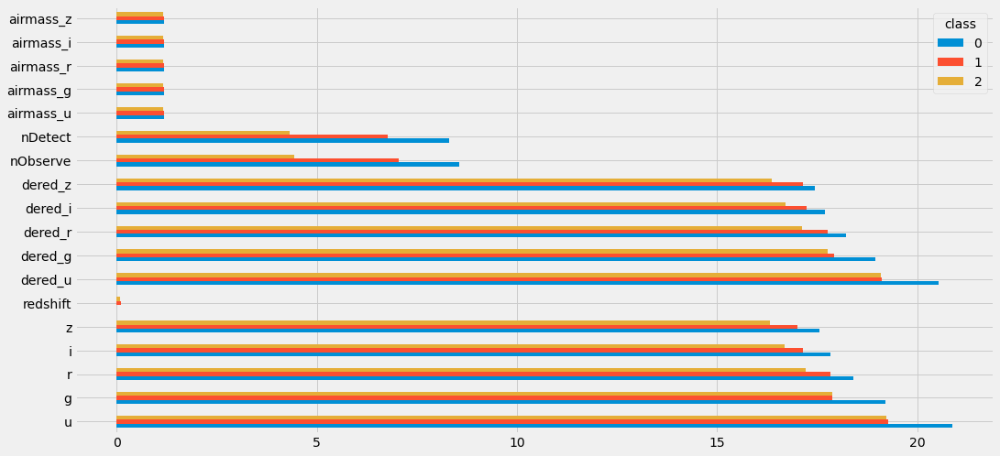

In [33]:
trn.groupby('class').mean().T.plot(kind='barh')

### test data

In [34]:
print(tst.shape)
tst.head()

(80000, 18)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z
id,,,,,,,,,,,,,,,,,,
320000,19.1431,18.0172,17.4733,17.1144,16.9263,1.2130e-01,19.0750,17.9550,17.4308,17.0838,16.9087,1,1,1.1563,1.1515,1.1613,1.1588,1.1539
320001,18.7409,17.1705,16.3691,15.9865,15.7307,-6.6907e-05,15.0703,14.3098,14.3901,14.5160,14.6372,2,2,1.0076,1.0074,1.0080,1.0078,1.0075
320002,19.2980,17.8803,17.2221,16.8096,16.6352,1.1001e-01,19.1004,17.7726,17.1460,16.7497,16.5689,1,1,1.3809,1.3905,1.3715,1.3761,1.3856
320003,18.0775,17.1569,16.9041,16.8118,16.7955,2.9697e-05,17.9729,17.0735,16.8470,16.7700,16.7668,1,1,1.1408,1.1408,1.1409,1.1408,1.1408
320004,17.8325,16.7646,16.2135,15.8722,15.6621,6.8471e-02,17.7545,16.6794,16.1563,15.8315,15.6433,2,2,1.1110,1.1077,1.1145,1.1127,1.1093


### train, test concatenation

In [35]:
df = pd.concat([trn, tst], axis=0) # 위아래 결합
print(df.shape)
df.tail()

(400000, 19)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
399995,19.6734,18.6617,18.2708,18.1225,18.0627,-0.0003,19.3361,18.3933,18.0860,17.9861,17.9670,17,17,1.1858,1.1863,1.1855,1.1857,1.1861,NaN
399996,21.5229,20.7283,20.6087,21.0049,20.8458,0.0655,21.3993,20.6399,20.5451,20.9507,20.7827,8,4,1.2850,1.2908,1.2793,1.2821,1.2878,NaN
399997,19.3991,18.2411,18.1605,18.1978,18.2018,-0.0008,18.9136,17.8753,17.9047,18.0043,18.0400,1,1,1.1885,1.1886,1.1885,1.1885,1.1885,NaN
399998,18.8997,17.6009,17.1329,16.8223,16.5946,0.0428,18.7715,17.4880,17.0557,16.7660,16.5585,17,17,1.1804,1.1813,1.1797,1.1800,1.1809,NaN
399999,20.7587,20.4252,20.5362,20.7729,20.9698,0.0003,20.4958,20.2181,20.3939,20.6696,20.9085,5,5,1.1832,1.1775,1.1889,1.1860,1.1803,NaN


In [36]:
df.fillna(-1, inplace=True) # 0은 값이기 때문에 넣으면 안됨
df.tail()

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class
id,,,,,,,,,,,,,,,,,,,
399995,19.6734,18.6617,18.2708,18.1225,18.0627,-0.0003,19.3361,18.3933,18.0860,17.9861,17.9670,17,17,1.1858,1.1863,1.1855,1.1857,1.1861,-1.0
399996,21.5229,20.7283,20.6087,21.0049,20.8458,0.0655,21.3993,20.6399,20.5451,20.9507,20.7827,8,4,1.2850,1.2908,1.2793,1.2821,1.2878,-1.0
399997,19.3991,18.2411,18.1605,18.1978,18.2018,-0.0008,18.9136,17.8753,17.9047,18.0043,18.0400,1,1,1.1885,1.1886,1.1885,1.1885,1.1885,-1.0
399998,18.8997,17.6009,17.1329,16.8223,16.5946,0.0428,18.7715,17.4880,17.0557,16.7660,16.5585,17,17,1.1804,1.1813,1.1797,1.1800,1.1809,-1.0
399999,20.7587,20.4252,20.5362,20.7729,20.9698,0.0003,20.4958,20.2181,20.3939,20.6696,20.9085,5,5,1.1832,1.1775,1.1889,1.1860,1.1803,-1.0


### 피쳐 변환

<AxesSubplot:>

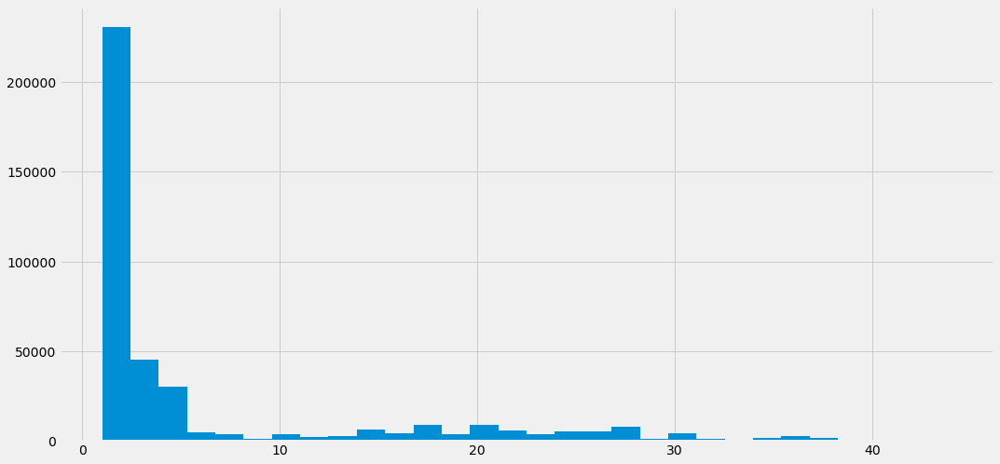

In [37]:
df['nObserve'].hist(bins=30) # Too skewed

<AxesSubplot:>

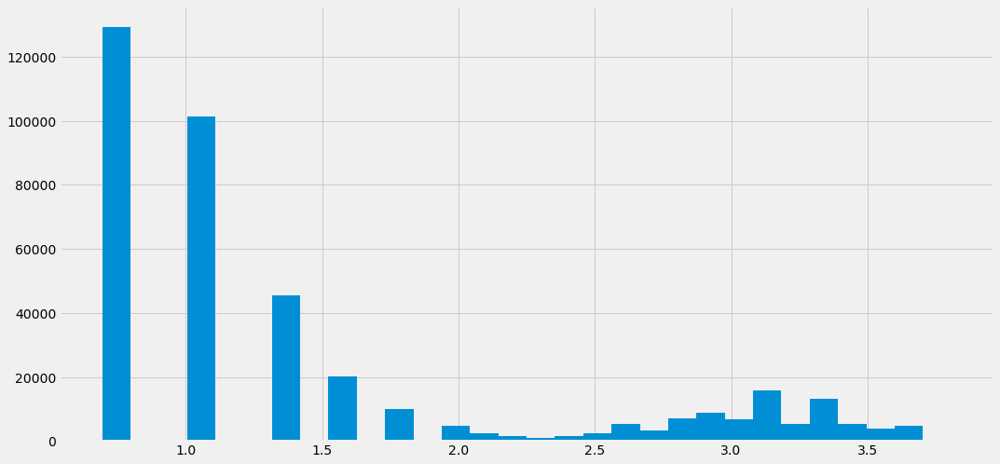

In [38]:
df['nObserve'] = df['nObserve'].apply(np.log1p)
df['nObserve'].hist(bins=30)

### 피쳐 생성

In [39]:
df['d_dered_u'] = df['dered_u'] - df['u']
df['d_dered_g'] = df['dered_g'] - df['g']
df['d_dered_r'] = df['dered_r'] - df['r']
df['d_dered_i'] = df['dered_i'] - df['i']
df['d_dered_z'] = df['dered_z'] - df['z']
df['d_dered_rg'] = df['dered_r'] - df['dered_g']
df['d_dered_ig'] = df['dered_i'] - df['dered_g']
df['d_dered_zg'] = df['dered_z'] - df['dered_g']
df['d_dered_ri'] = df['dered_r'] - df['dered_i']
df['d_dered_rz'] = df['dered_r'] - df['dered_z']
df['d_dered_iz'] = df['dered_i'] - df['dered_z']
df['d_obs_det'] = df['nObserve'] - df['nDetect']
print(df.shape)
df.head()

(400000, 31)


,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_rg,d_dered_ig,d_dered_zg,d_dered_ri,d_dered_rz,d_dered_iz,d_obs_det
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,23.2640,20.3368,19.0095,17.6724,16.9396,-8.1086e-05,23.1243,20.2578,18.9551,17.6321,16.9089,2.9444,18,1.1898,1.1907,1.1890,1.1894,1.1902,0.0,-0.1397,-0.0790,-0.0544,-0.0403,-0.0307,-1.3027,-2.6257,-3.3488,1.3230,2.0462,0.7232,-15.0556
1,15.0521,14.0620,13.4524,13.2684,13.1689,4.5061e-03,14.9664,14.0045,13.4114,13.2363,13.1347,0.6931,1,1.2533,1.2578,1.2488,1.2510,1.2555,1.0,-0.0857,-0.0574,-0.0410,-0.0322,-0.0343,-0.5931,-0.7683,-0.8698,0.1751,0.2767,0.1016,-0.3069
2,16.7864,15.8254,15.5363,15.3935,15.3500,4.7198e-04,16.6076,15.6866,15.4400,15.3217,15.2961,1.0986,2,1.0225,1.0241,1.0210,1.0217,1.0233,0.0,-0.1787,-0.1388,-0.0963,-0.0718,-0.0540,-0.2466,-0.3649,-0.3905,0.1183,0.1440,0.0257,-0.9014
3,25.6606,21.1887,20.2212,19.8949,19.6346,5.8143e-06,25.3536,20.9947,20.0873,19.7947,19.5552,1.6094,3,1.2054,1.2061,1.2049,1.2051,1.2057,0.0,-0.3070,-0.1941,-0.1339,-0.1003,-0.0795,-0.9074,-1.2000,-1.4395,0.2926,0.5321,0.2395,-1.3906
4,24.4534,20.6992,19.0424,18.3242,17.9826,-3.3247e-05,23.7714,20.4338,18.8630,18.1903,17.8759,2.6391,12,1.1939,1.1943,1.1937,1.1938,1.1941,0.0,-0.6820,-0.2653,-0.1794,-0.1339,-0.1067,-1.5709,-2.2436,-2.5579,0.6727,0.9871,0.3144,-9.3609


### 피쳐 삭제

In [40]:
df.corr().style.background_gradient()
# u, dered_u 는 비슷하므로 하나만 사용해도 되겠다는 결론 도출 가능
# airmass column들은 상관계수가 거의 1 => 하나만 사용해도 ㄱㅊ

,u,g,r,i,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,nDetect,airmass_u,airmass_g,airmass_r,airmass_i,airmass_z,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_rg,d_dered_ig,d_dered_zg,d_dered_ri,d_dered_rz,d_dered_iz,d_obs_det
u,1.0000,0.0543,0.8159,0.0194,0.0145,-0.0085,0.9347,0.0904,0.7810,0.0389,0.0231,0.2398,0.2211,0.0768,0.0765,0.0769,0.0768,0.0767,-0.2378,-0.2140,-0.0061,-0.1284,-0.0016,0.0016,-0.0182,-0.0357,-0.0196,0.0124,0.0094,0.0020,-0.2174
g,0.0543,1.0000,0.0556,0.5913,0.5315,-0.0003,0.0525,0.9987,0.0538,0.7074,0.4478,0.0130,0.0127,0.0027,0.0027,0.0028,0.0027,0.0027,-0.0142,-0.0069,-0.9977,-0.0063,-0.4753,-0.3233,-0.9986,-0.0021,-0.0011,-0.7049,-0.4458,0.0001,-0.0126
r,0.8159,0.0556,1.0000,0.0256,0.0199,-0.0055,0.8037,0.0953,0.9684,0.0530,0.0330,0.2171,0.1954,0.0772,0.0768,0.0774,0.0773,0.0770,-0.2346,-0.0620,-0.0025,-0.1127,-0.0005,0.0036,-0.0057,-0.0207,-0.0110,0.0106,0.0073,0.0007,-0.1915
i,0.0194,0.5913,0.0256,1.0000,0.8991,-0.0001,0.0195,0.5901,0.0252,0.9878,0.6254,0.0054,0.0061,-0.0002,-0.0003,-0.0001,-0.0002,-0.0002,-0.0079,-0.0005,-0.5904,-0.0010,-0.9903,-0.6738,-0.5907,0.8047,0.4028,-0.9876,-0.6247,0.0000,-0.0061
z,0.0145,0.5315,0.0199,0.8991,1.0000,-0.0002,0.0144,0.5303,0.0196,0.8881,0.7096,0.0042,0.0053,-0.0002,-0.0002,-0.0001,-0.0002,-0.0002,-0.0083,-0.0009,-0.5309,-0.0007,-0.8904,-0.7360,-0.5311,0.7237,0.5270,-0.8881,-0.7092,-0.1904,-0.0054
redshift,-0.0085,-0.0003,-0.0055,-0.0001,-0.0002,1.0000,-0.0080,-0.0002,-0.0028,-0.0001,-0.0001,-0.0092,-0.0067,0.0011,0.0011,0.0011,0.0011,0.0011,0.0484,0.0016,0.0005,0.0106,0.0002,0.0001,-0.0001,0.0001,-0.0000,-0.0001,-0.0000,0.0001,0.0064
dered_u,0.9347,0.0525,0.8037,0.0195,0.0144,-0.0080,1.0000,0.0969,0.8392,0.0423,0.0249,0.2337,0.2172,0.0889,0.0885,0.0892,0.0891,0.0887,-0.2120,0.1470,0.0068,0.1521,0.0013,0.0036,-0.0194,-0.0374,-0.0209,0.0128,0.0100,0.0025,-0.2138
dered_g,0.0904,0.9987,0.0953,0.5901,0.5303,-0.0002,0.0969,1.0000,0.0990,0.7072,0.4476,0.0222,0.0212,0.0071,0.0070,0.0072,0.0071,0.0070,-0.0219,0.0149,-0.9928,0.0158,-0.4733,-0.3218,-0.9957,-0.0037,-0.0020,-0.7018,-0.4437,0.0002,-0.0209
dered_r,0.7810,0.0538,0.9684,0.0252,0.0196,-0.0028,0.8392,0.0990,1.0000,0.0549,0.0340,0.2100,0.1899,0.0848,0.0843,0.0852,0.0850,0.0845,-0.2139,0.1329,0.0065,0.1388,0.0018,0.0048,-0.0065,-0.0217,-0.0117,0.0108,0.0076,0.0010,-0.1863
dered_i,0.0389,0.7074,0.0530,0.9878,0.8881,-0.0001,0.0423,0.7072,0.0549,1.0000,0.6331,0.0118,0.0119,0.0026,0.0026,0.0027,0.0027,0.0026,-0.0136,0.0080,-0.7048,0.0082,-0.9566,-0.6508,-0.7056,0.7044,0.3526,-0.9978,-0.6312,0.0000,-0.0119


In [41]:
df.drop(['airmass_z', 'airmass_i', 'airmass_r', 'airmass_g', 'u', 'g', 'r', 'i', 'nDetect', 'd_dered_rg', 'd_dered_ri'], 
        axis=1, inplace=True)
print(df.shape)
df.head()

(400000, 20)


,z,redshift,dered_u,dered_g,dered_r,dered_i,dered_z,nObserve,airmass_u,class,d_dered_u,d_dered_g,d_dered_r,d_dered_i,d_dered_z,d_dered_ig,d_dered_zg,d_dered_rz,d_dered_iz,d_obs_det
id,,,,,,,,,,,,,,,,,,,,
0,16.9396,-8.1086e-05,23.1243,20.2578,18.9551,17.6321,16.9089,2.9444,1.1898,0.0,-0.1397,-0.0790,-0.0544,-0.0403,-0.0307,-2.6257,-3.3488,2.0462,0.7232,-15.0556
1,13.1689,4.5061e-03,14.9664,14.0045,13.4114,13.2363,13.1347,0.6931,1.2533,1.0,-0.0857,-0.0574,-0.0410,-0.0322,-0.0343,-0.7683,-0.8698,0.2767,0.1016,-0.3069
2,15.3500,4.7198e-04,16.6076,15.6866,15.4400,15.3217,15.2961,1.0986,1.0225,0.0,-0.1787,-0.1388,-0.0963,-0.0718,-0.0540,-0.3649,-0.3905,0.1440,0.0257,-0.9014
3,19.6346,5.8143e-06,25.3536,20.9947,20.0873,19.7947,19.5552,1.6094,1.2054,0.0,-0.3070,-0.1941,-0.1339,-0.1003,-0.0795,-1.2000,-1.4395,0.5321,0.2395,-1.3906
4,17.9826,-3.3247e-05,23.7714,20.4338,18.8630,18.1903,17.8759,2.6391,1.1939,0.0,-0.6820,-0.2653,-0.1794,-0.1339,-0.1067,-2.2436,-2.5579,0.9871,0.3144,-9.3609


### 새로운 학습 데이터 파일 저장

In [42]:
data_dir=Path('input/')
feature_file = data_dir / 'feature.csv'
seed = 42

In [43]:
df.to_csv(feature_file)